In [1]:
#Run inference in tiles without having to save tiled images separately using Sahi
#Based off of: https://colab.research.google.com/github/obss/sahi/blob/main/demo/inference_for_yolov5.ipynb?v=1#scrollTo=yXyP3T0wyGtF

#Import necessary modules
import os
os.getcwd()

from sahi.utils.yolov5 import (
    download_yolov5s6_model,
)

from sahi import AutoDetectionModel
from sahi.utils.cv import read_image
from sahi.utils.file import download_from_url
from sahi.predict import get_prediction, get_sliced_prediction, predict
from IPython.display import Image

In [17]:
#Set detection model parameters

yolov5_model_path = 'E:\\training\\Base\\YOLOweights\\zooniverse_3class_150epc\\weights\\best.pt' 
download_yolov5s6_model(destination_path=yolov5_model_path)

detection_model = AutoDetectionModel.from_pretrained(
    model_type = 'yolov5', #works with different architectures, for future reference
    model_path = yolov5_model_path,
    confidence_threshold = 0.75, #Can specify according to need
    device = "cuda:0" #to use GPU, can also use CPU but why would you?
)

YOLOv5  2023-7-27 Python-3.10.9 torch-2.0.1+cpu CPU

Fusing layers... 
Model summary: 214 layers, 7027720 parameters, 0 gradients, 16.0 GFLOPs
Adding AutoShape... 


Performing prediction on 72 number of slices.


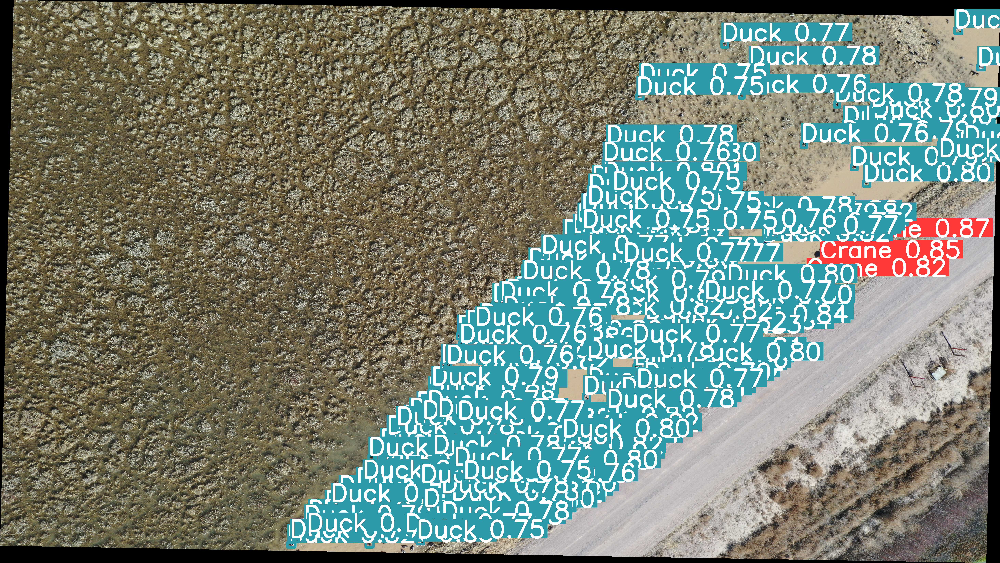

In [24]:
#Run test inference and visualize result on a single image; save image output
path = "E:\\sample\\12c01\\" #Image directory
img = "BDA_12c01_20181127_00474_Projected.tif" #example image
image = path+img

result = get_sliced_prediction(
    image,
    detection_model,
    slice_height = 456,
    slice_width = 781,
    overlap_height_ratio = 0.1,
    overlap_width_ratio = 0.1
)

#Save as COCO annotations-- add image ID to annotation
coco = result.to_coco_annotations()
for annotation in coco:
    annotation['image_id'] = img

#Display detection output
result.export_visuals(path) #Specify directory
Image(path+"prediction_visual.png")

In [ ]:
#Set parameters for batch prediction

model_type = "yolov5"
model_path = yolov5_model_path
model_device = 'cuda:0' # to use GPU
model_confidence_threshold = 0.3 #specify according to need

slice_height = 456 #specify according to need
slice_width = 781 #specify according to need
overlap_height_ratio = 0.1 #specify according to need
overlap_width_ratio = 0.1 #specify according to need

source_image_dir = "" #Specify image directory


In [ ]:
#Currently this only outputs images, no text output of annotations; need to fix it
result = predict(
    model_type=model_type,
    model_path=model_path,
    model_device=model_device,
    model_confidence_threshold=model_confidence_threshold,
    source=source_image_dir,
    slice_height=slice_height,
    slice_width=slice_width,
    overlap_height_ratio=overlap_height_ratio,
    overlap_width_ratio=overlap_width_ratio,
)